# Confronto dell'evapotraspirazione a Calliano tra il 1935 e il 2020


Basato sui notebook di Concetta D'Amato, Niccolò Tubini, Michele Bottazzi e Riccardo Rigon.

Autori: Niccolò Schiavi Cappello, Marco Feltrin e Alessandro Lagrecacolonna.

Licenza Creative Commons BY-NC 4.0

I modelli digitali del terreno sono stati presi dal sito della Provincia Autonoma di Trento

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
import plotly.express as px
import plotly.graph_objects as go
import os
from GEOSPACE_Output import*
import warnings
import datetime
import warnings
import xarray as xr
from matplotlib import rc
import matplotlib.style as style
import matplotlib.dates as mdates
from IPython.display import Image
from GEOSPACE_Output import*
warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)
oms_project_path = os.path.dirname(os.getcwd())
os.chdir(oms_project_path+'/output/calliano/1')

## Introduzione

Lo scopo di questo notebook consiste nell'analizzare e nel confrontare l'evaporazione dal suolo nudo e l'evapotraspirazione negli anni 2020 e 1935. Questa analisi vuole evidenziare in modo concreto il ruolo del surriscaldamento globale sui fenomeni di evaporazione ed evapotraspirazione.

Per raggiungere questo scopo si è effettuata un'analisi con il metodo Penmann-Monteth-FAO, andando ad attivare i fattori di temperature stress e radiation stress.

Come periodo di analisi si sono considerati gli anni 1935 e 2020 per intero, si è supposto inoltre che l'intera zona di studio fosse coltivata a vigneto.

Come zona di analisi si è utilizzato un riquadro di 2.5 kilometri quadrati nella zona di Calliano, i dati di temperatura si sono ricavati da Meteotrentino, mentre la radiazione è stata calcolata attraverso delle simulazioni. 
Per tutti gli altri dati si sono utilizzati sia per il 1935 sia per il 2020 i dati riferiti al 2020 (i dati del 1935 non sono disponibili), questa decisione è supportata da una similitudine pluviometrica tra i due anni.

Questa scelta accentua maggiormente il cambiamento dell'evapotraspirazione a causa del surriscaldamento globale.

I parametri forniti al modello sono: temperatura, radiazione netta, flusso di calore dal suolo, umidità dell'aria, contenuto d'acqua del suolo, velocità del vento e pressione atmosferica.

I parametri riguardanti la vegetazione sono stati ricavati dalle tabelle presenti sul sito della FAO.

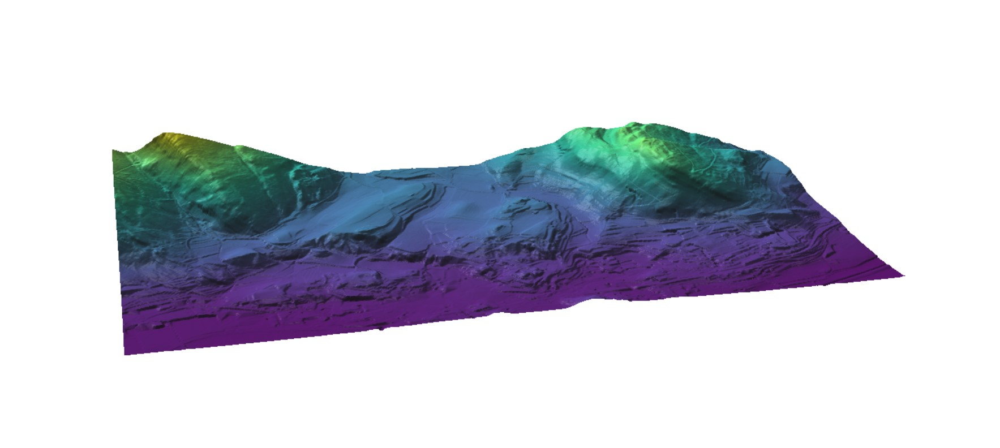

In [2]:
Image("C:\\Users\marco\Desktop\progetto_idrologia_Evaptra\JupyterNotebook\dtm.jpg")

DTM Calliano

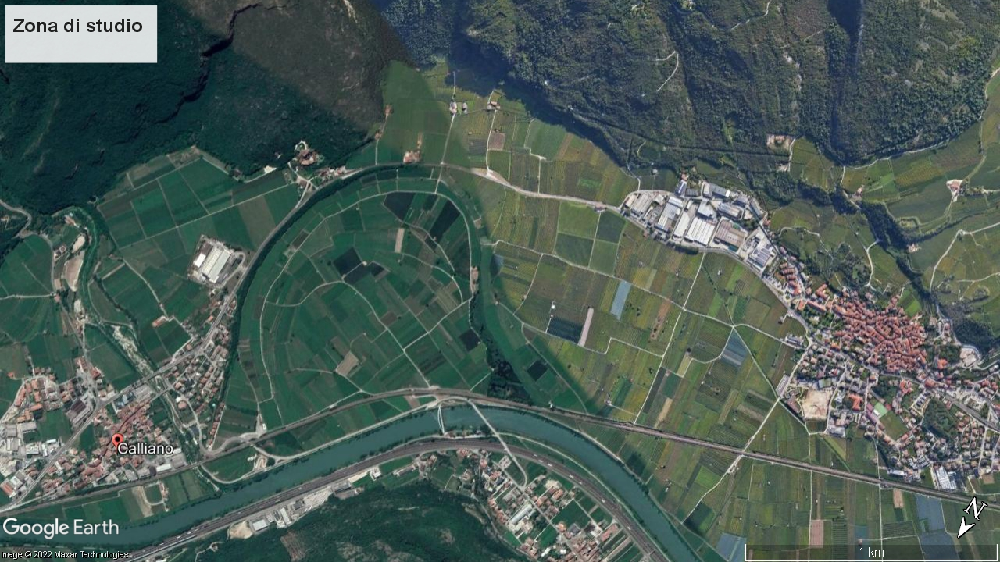

In [3]:
Image("C:\\Users\marco\Desktop\progetto_idrologia_Evaptra\JupyterNotebook\overview.jpg")

## Analisi dei dati di temperatura

In [4]:
temp35=pd.read_csv('35-36.csv')

In [5]:
temp20=pd.read_csv('20_21_t.csv')

In [6]:
df=pd.DataFrame(columns=['2020','1935'])
df['2020']=temp20
df['1935']=temp35

Text(0, 0.5, 'Gradi [°C]')

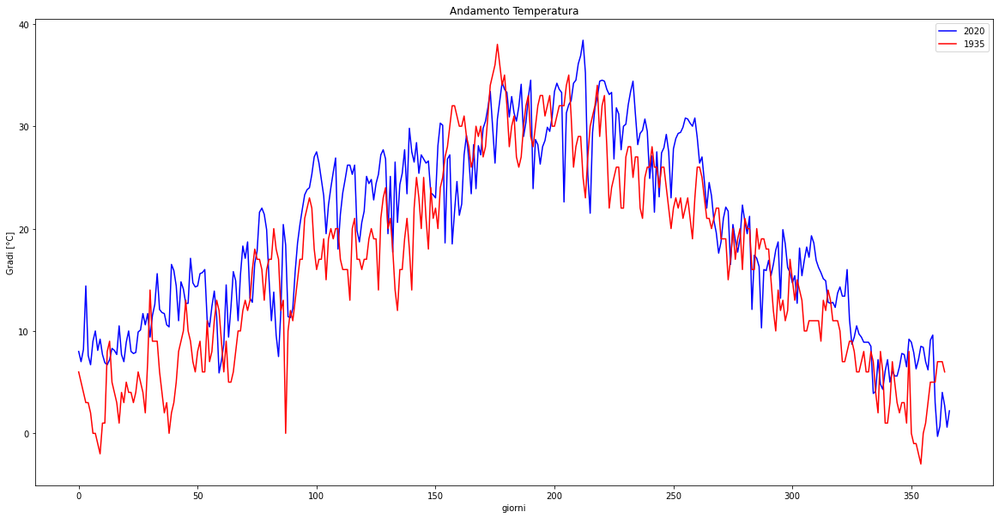

In [7]:
a=df.plot(color=['blue','red'],figsize=[20,10])
a.set_title('Andamento Temperatura')
a.set_xlabel('giorni')
a.set_ylabel('Gradi [°C]')

In [8]:
temp20.mean()

Colonna1    19.608992
dtype: float64

In [9]:
temp35.mean()

8    16.632877
dtype: float64

# Confronto tra le evapotraspirazioni ricavate con Penmann-Montieth-FAO

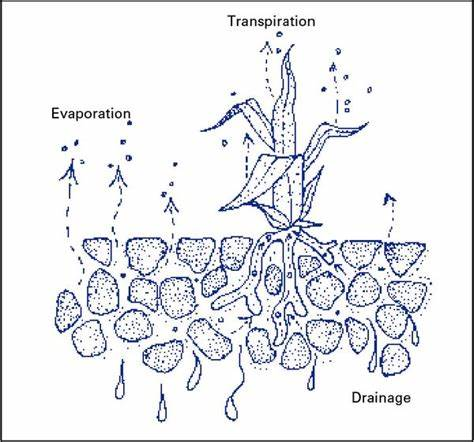

In [10]:
Image("C:\\Users\marco\Desktop\progetto_idrologia_Evaptra\JupyterNotebook\evapotranspiration.jpg")

https://www.bing.com/images/search?view=detailV2&ccid=hTJbp4Ae&id=7BCE988AEF966D5D224C21D9CC968961CA4EF16D&thid=OIP.hTJbp4AeCMad7JLST4ovFgHaG6&mediaurl=https%3A%2F%2Fcontent.ces.ncsu.edu%2Fmedia%2Fimages%2FFigure_5_zr3jLXT.jpg&cdnurl=https%3A%2F%2Fth.bing.com%2Fth%2Fid%2FR.85325ba7801e08c69dec92d24f8a2f16%3Frik%3DbfFOymGJlszZIQ%26pid%3DImgRaw%26r%3D0&exph=560&expw=600&q=soil+evaporation+scheme+&simid=608015211659144926&form=IRPRST&ck=D6A931BF1CA2A180AFB6E2B6A8AAD6DF&selectedindex=41&ajaxhist=0&ajaxserp=0&vt=0&sim=11

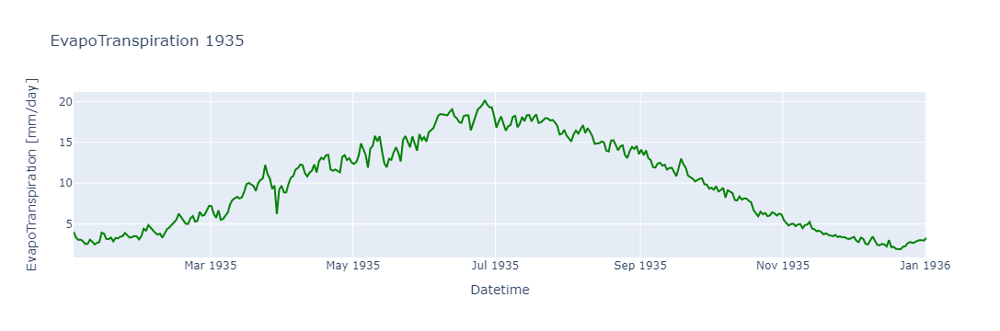

In [11]:
df1 = pd.read_csv('EvapoTranspiration_FAO35_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df1.columns = ['Datetime','EvapoTranspiration [mm/day]']
fig = px.line(df1, x='Datetime', y='EvapoTranspiration [mm/day]', title='EvapoTranspiration 1935')
fig.update_traces(line_color='green')
fig.show()


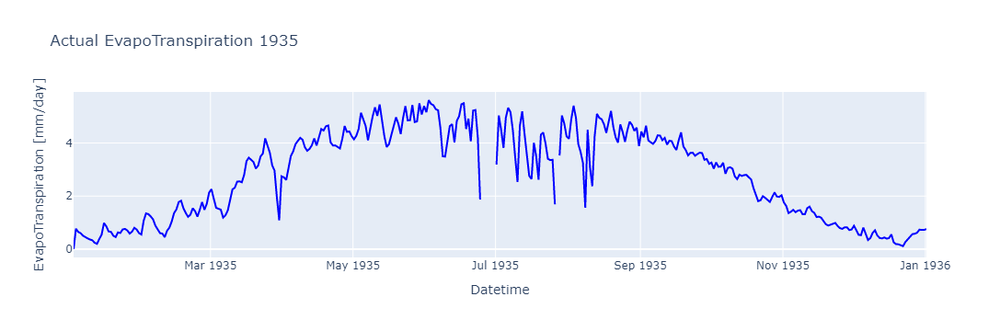

In [12]:
df3 = pd.read_csv('temperaturestressET35_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df3.columns = ['Datetime','EvapoTranspiration [mm/day]']
fig = px.line(df3, x='Datetime', y='EvapoTranspiration [mm/day]', title='Actual EvapoTranspiration 1935')
fig.update_traces(line_color='blue')
fig.show()

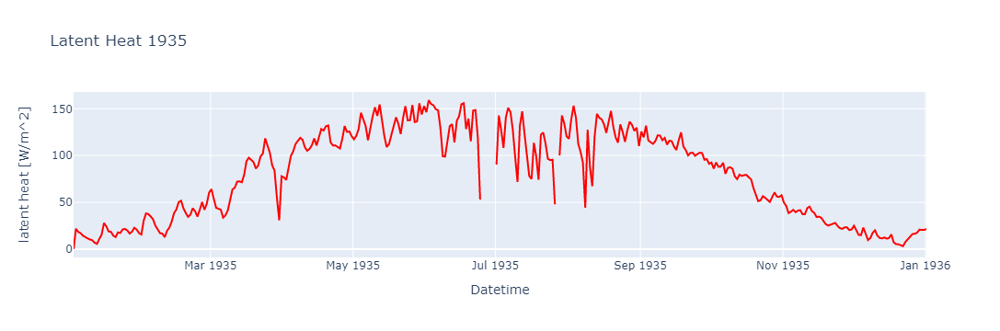

In [13]:
df2 = pd.read_csv('temperaturestressLH35_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Datetime','latent heat [W/m^2]']
fig = px.line(df2, x='Datetime', y='latent heat [W/m^2]', title='Latent Heat 1935')
fig.update_traces(line_color='red')
fig.show()

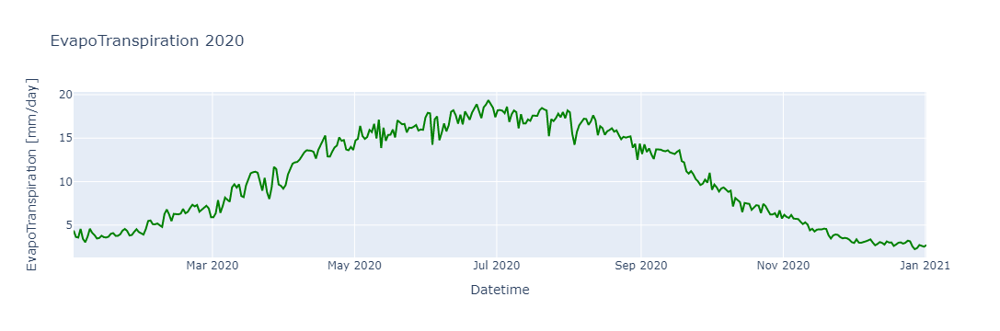

In [14]:
df4 = pd.read_csv('EvapoTranspiration_FAO20_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','EvapoTranspiration [mm/day]']
fig = px.line(df4, x='Datetime', y='EvapoTranspiration [mm/day]', title='EvapoTranspiration 2020')
fig.update_traces(line_color='green')
fig.show()

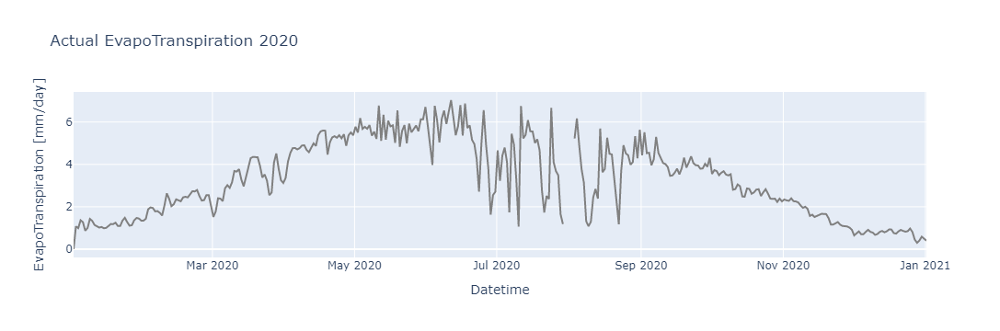

In [15]:
df6 = pd.read_csv('temperaturestressET20_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','EvapoTranspiration [mm/day]']
fig = px.line(df6, x='Datetime', y='EvapoTranspiration [mm/day]', title='Actual EvapoTranspiration 2020')
fig.update_traces(line_color='grey')
fig.show()

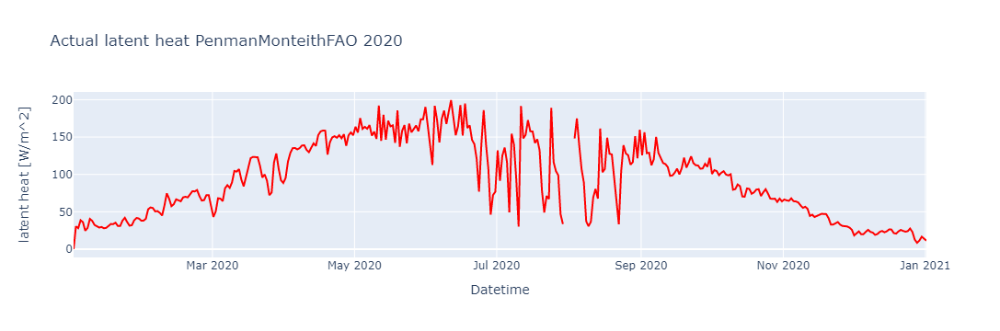

In [16]:
df5 = pd.read_csv('temperaturestressLH20_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','latent heat [W/m^2]']
fig = px.line(df5, x='Datetime', y='latent heat [W/m^2]', title='Actual latent heat PenmanMonteithFAO 2020')
fig.update_traces(line_color='red')
fig.show()

In [17]:
q=[]
w=[]
for i in range (0,366):
    q.append(i)
for j in range (0,367):
    w.append(j)
df2['day']=q
df3['day']=q
df5['day']=w
df6['day']=w

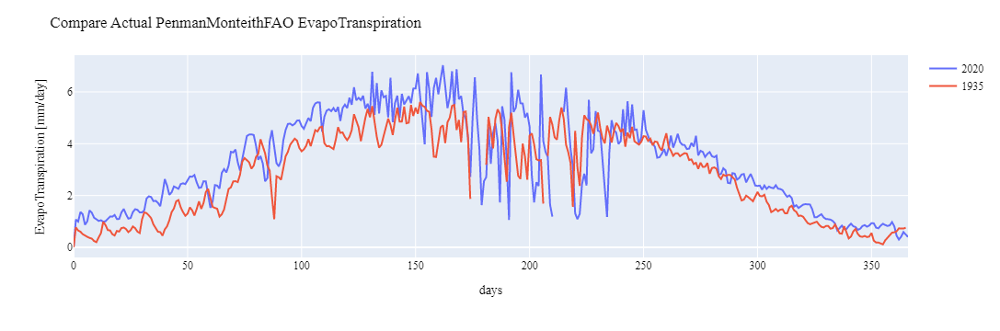

In [18]:
fig = px.line()
fig.add_trace(go.Scatter(x=df6['day'], y=df6['EvapoTranspiration [mm/day]'], mode='lines', name='2020'))
fig.add_trace(go.Scatter(x=df3['day'], y=df3['EvapoTranspiration [mm/day]'], mode='lines', name='1935'))

fig.update_layout(
    title='Compare Actual PenmanMonteithFAO EvapoTranspiration ',
    xaxis_title="days",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTranspiration [mm/day]",
    font=dict(size=12))
fig.show()

In [19]:
df6['EvapoTranspiration [mm/day]'].mean()    #media del 2020

3.3092100732973333

In [20]:
df3['EvapoTranspiration [mm/day]'].mean()    #media del 1935

2.8118733334474615

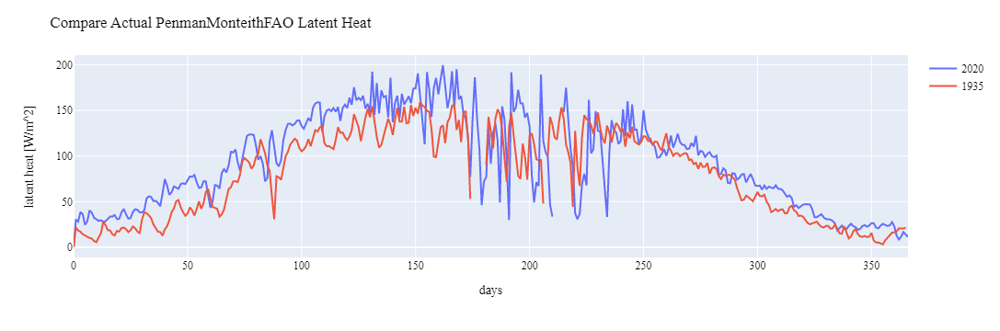

In [21]:
fig = px.line()
fig.add_trace(go.Scatter(x=df5['day'], y=df5['latent heat [W/m^2]'], mode='lines', name='2020'))
fig.add_trace(go.Scatter(x=df2['day'], y=df2['latent heat [W/m^2]'], mode='lines', name='1935'))

fig.update_layout(
    title='Compare Actual PenmanMonteithFAO Latent Heat ',
    xaxis_title="days",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="latent heat [W/m^2]",
    font=dict(size=12))
fig.show()

## Confronto tra le evaporazioni dal suolo ricavate col metodo Penmann-Montieth-FAO

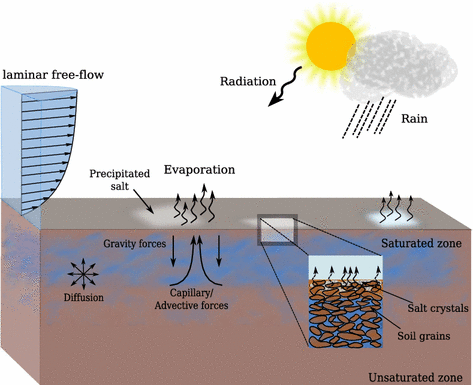

In [67]:
Image("C:\\Users\marco\Desktop\progetto_idrologia_Evaptra\JupyterNotebook\evaporation.png")

https://www.bing.com/images/search?view=detailV2&ccid=KsRqzLOm&id=E6636279032695DE73D7AB61E219CC92B182BA3A&thid=OIP.KsRqzLOmuph-nD-pPukqNgAAAA&mediaurl=https%3a%2f%2fmedia.springernature.com%2flw785%2fspringer-static%2fimage%2fart%253A10.1007%252Fs11242-015-0516-7%2fMediaObjects%2f11242_2015_516_Fig1_HTML.gif&cdnurl=https%3a%2f%2fth.bing.com%2fth%2fid%2fR.2ac46accb3a6ba987e9c3fa93ee92a36%3frik%3dOrqCsZLMGeJhqw%26pid%3dImgRaw%26r%3d0&exph=385&expw=473&q=soil+evaporation+scheme+&simid=607998787702769675&FORM=IRPRST&ck=DDBA10428A4ED0F5BEF7B0C8E1534202&selectedIndex=264&ajaxhist=0&ajaxserp=0

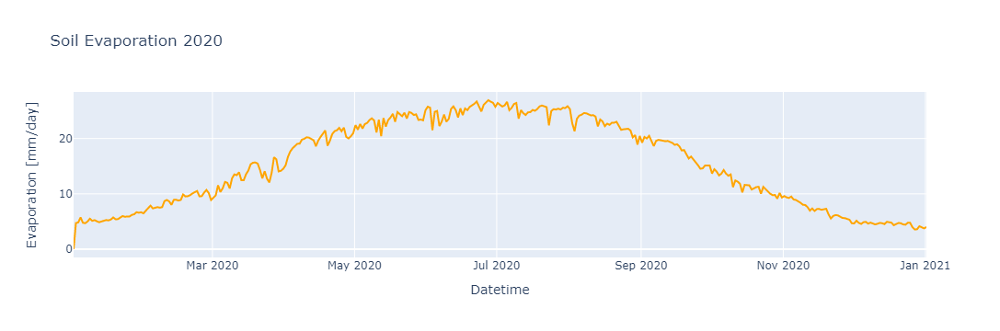

In [23]:
df7 = pd.read_csv('StressedEvaporation20_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df7.columns = ['Datetime','Evaporation [mm/day]']
fig = px.line(df7, x='Datetime', y='Evaporation [mm/day]', title='Soil Evaporation 2020')
fig.update_traces(line_color='orange')
fig.show()

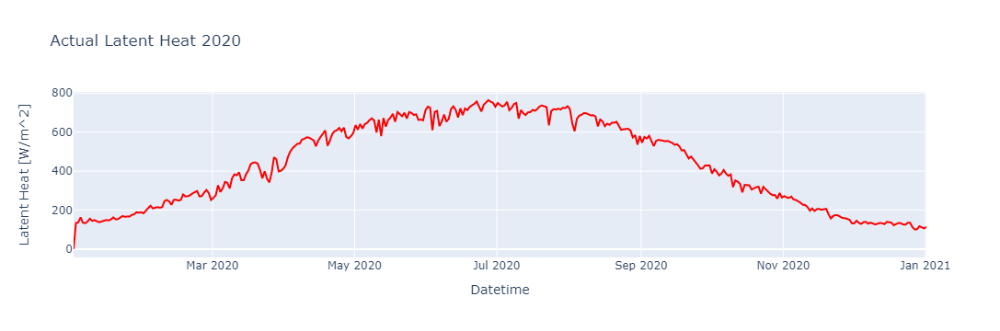

In [24]:
df8 = pd.read_csv('StressedFluxEvaporation20_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df8.columns = ['Datetime','Latent Heat [W/m^2]']
fig = px.line(df8, x='Datetime', y='Latent Heat [W/m^2]', title=' Actual Latent Heat 2020')
fig.update_traces(line_color='red')
fig.show()

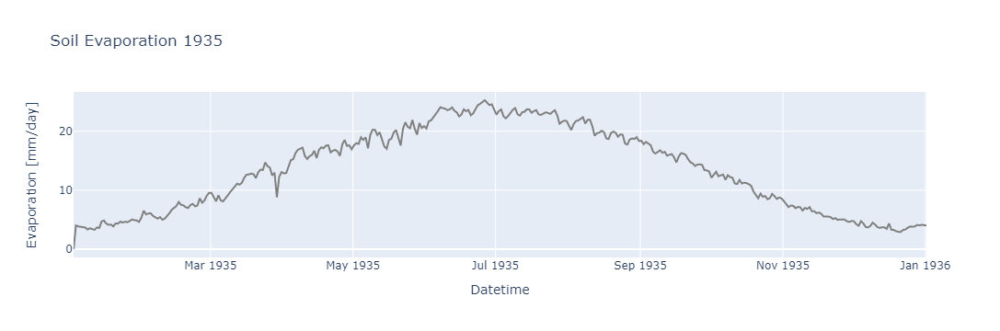

In [25]:
df9 = pd.read_csv('StressedEvaporation35_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df9.columns = ['Datetime','Evaporation [mm/day]']
fig = px.line(df9, x='Datetime', y='Evaporation [mm/day]', title='Soil Evaporation 1935')
fig.update_traces(line_color='grey')
fig.show()

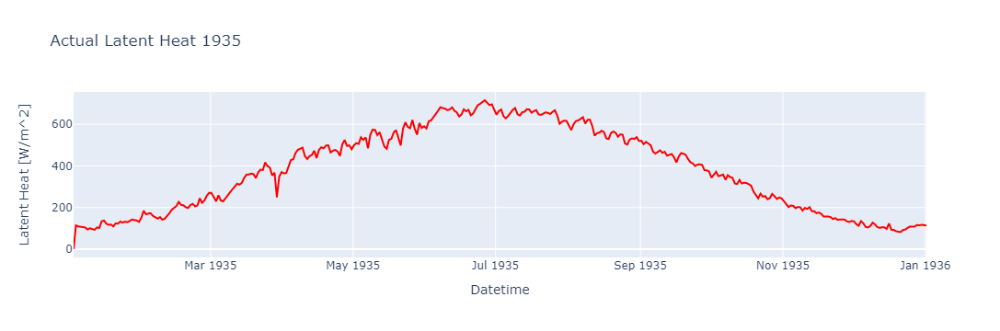

In [26]:
df10 = pd.read_csv('StressedFluxEvaporation35_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df10.columns = ['Datetime','Latent Heat [W/m^2]']
fig = px.line(df10, x='Datetime', y='Latent Heat [W/m^2]', title=' Actual Latent Heat 1935')
fig.update_traces(line_color='red')
fig.show()

In [27]:
q=[]
w=[]
for i in range (0,366):
    q.append(i)
for j in range (0,367):
    w.append(j)
df9['day']=q
df7['day']=w

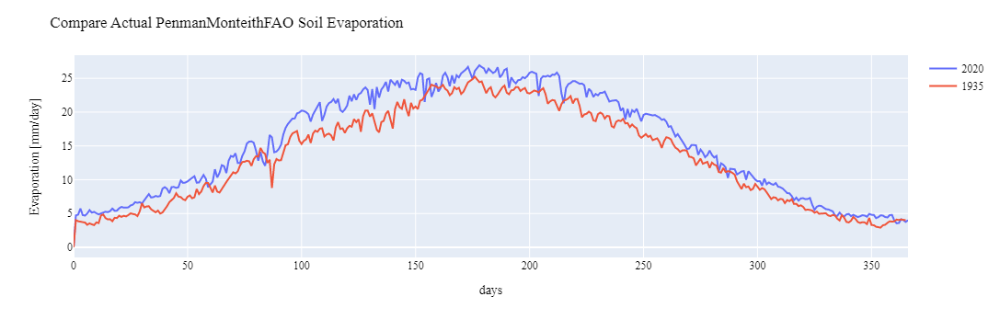

In [28]:
fig = px.line()
fig.add_trace(go.Scatter(x=df7['day'], y=df7['Evaporation [mm/day]'], mode='lines', name='2020'))
fig.add_trace(go.Scatter(x=df9['day'], y=df9['Evaporation [mm/day]'], mode='lines', name='1935'))

fig.update_layout(
    title='Compare Actual PenmanMonteithFAO Soil Evaporation ',
    xaxis_title="days",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Evaporation [mm/day]",
    font=dict(size=12))
fig.show()

In [29]:
df7['Evaporation [mm/day]'].mean()  

15.411473462419494

In [30]:
df9['Evaporation [mm/day]'].mean()  

13.397228607930598

Dalle simulazioni si evince come l'aumento di temperatura, dovuto al surriscaldamento globale, abbia portato ad un significativo aumento dei fenomeni di evapotraspirazione ed evaporazione.

----
----

# Valutazione degli effetti di due possibili scenari climatici su impianto di vite a Calliano con ProsperoPM
- Author of the source code Concetta D'Amato, Niccolò Tubini, Michele Bottazzi and Riccardo Rigon
- Modified by Niccolò Schiavi Cappello, Marco Feltrin and Alessandro Lagrecacolonna
-------

Lo scopo di questo notebbok è di simulare i possibili scenari ai quali si deve far fronte nella gestione di una coltura da reddito nel territorio di Calliano.
Nello specifico si vogliono analizzare ed evidenziare i periodi di maggiore criticità generati da carenze idriche in modo da poter progettare delle soluzioni che permettano di arginare il deficit produttivo.

Sono stati ipotizzati due differenti scenari: entrambi hanno in comune un periodo invernale siccitoso (dati riferiti all'inverno 2021-2022) ma si differenziano per le precipitazioni nel periodo estivo:
- scenario 1: estate piovosa con 491mm (estate 2014)
- scenario 2: estate secca con 195mm (estate 2004)

I dati meterologici utilizzati per il modello e le simulazioni provengono da Meteotrentino e sono stati raccolti dalla stazione di Rovereto, mentre i dati geografici (DTM) provengono dal portale geocartografico della provincia autonoma di Trento.
I dati inerenti l'umidità del suolo a 75cm di profondità sono stati ricavati tramite i notebook sull'infiltrazione utilizzando i dati pluviometrici di Rovereto e una colonna stratigrafica composta da detrito carbonatico con limo.

## input necessari per la simulazione
- Dem
- Centroids
- Temperatura dell'aria
- Velocità del vento
- Umidità Relativa 
- Radiazione onda corta diretta
- Radiazione onda corta diffusa
- Radiazione onda lunga
- Radiazione netta
- Pressione atmosferica
- Leaf Area Index (LAI)
- Contenuto d'acqua nel suolo -(dati estratti dalla simulazione di WHETGEO, con i dati del terreno presi dall' atlante geologico provinciale) 
- Flusso di calore dal suolo
----
## output della simulazione
- Calore latente per le parti al sole e all ombra della chioma [$W/m^{2}$];
- Flusso di Evaporatione, Traspiratione, Evapotranspiratione [$W/m^{2}$];
- Evapotranspiratione [$mm$];
- Temperatra delle foglie esposte al sole e all' ombra [$W/m^{2}$];
- Calore sensibile per la chioma espota al sole e all'ombra [$W/m^{2}$];
- Frazione di chioma illuminata [-];
- Radiazione a onda corta assorbita dalla chioma al sole e all' ombra [$W/m^{2}$];

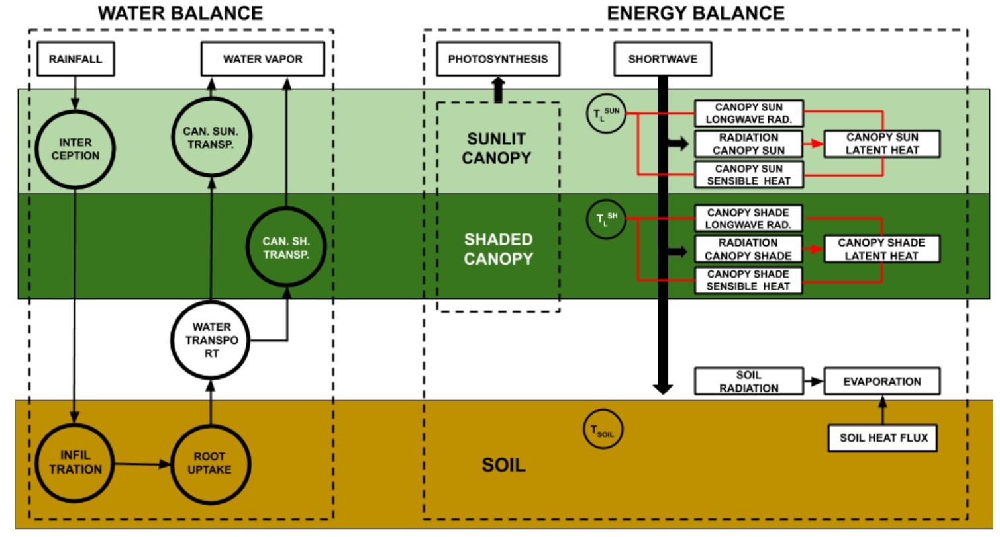

In [31]:
Image("C:\\Users\marco\Desktop\progetto_idrologia_Evaptra\JupyterNotebook\Prospero function.jpg")

Immagine presa dalla tesi di Michele Bottazzi, Transpiration theory and theProspero component of GEOframe 
:https://osf.io/bekwd

I vari valori di LAI sono stati presi dai dati sperimentali da un paper, per maggiori informazioni: https://www.researchgate.net/publication/225666686_Water_use_and_the_development_of_seasonal_crop_coefficients_for_Superior_Seedless_grapevines_trained_to_an_open-gable_trellis_system

dove si ipotizza un sesto di impianto a pergola doppia trentina

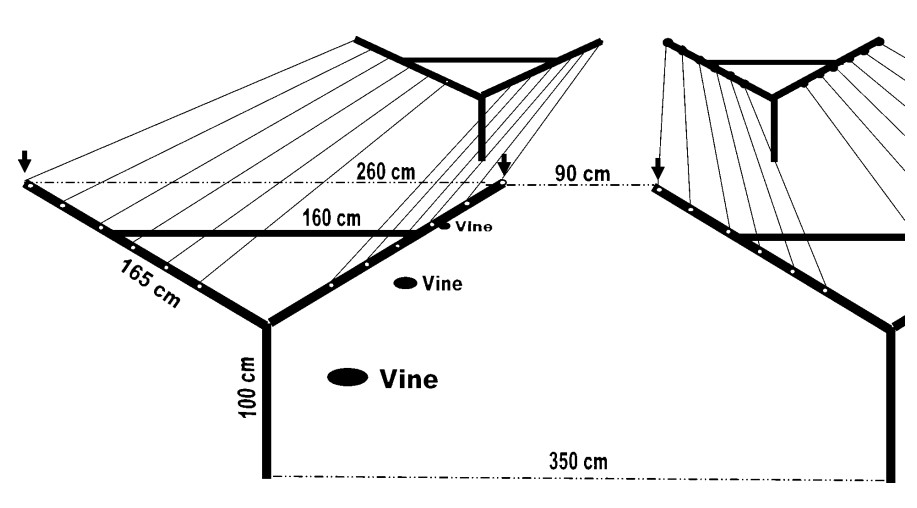

In [32]:
Image("C:\\Users\marco\Desktop\progetto_idrologia_Evaptra\JupyterNotebook\sesto_impianto.jpg")

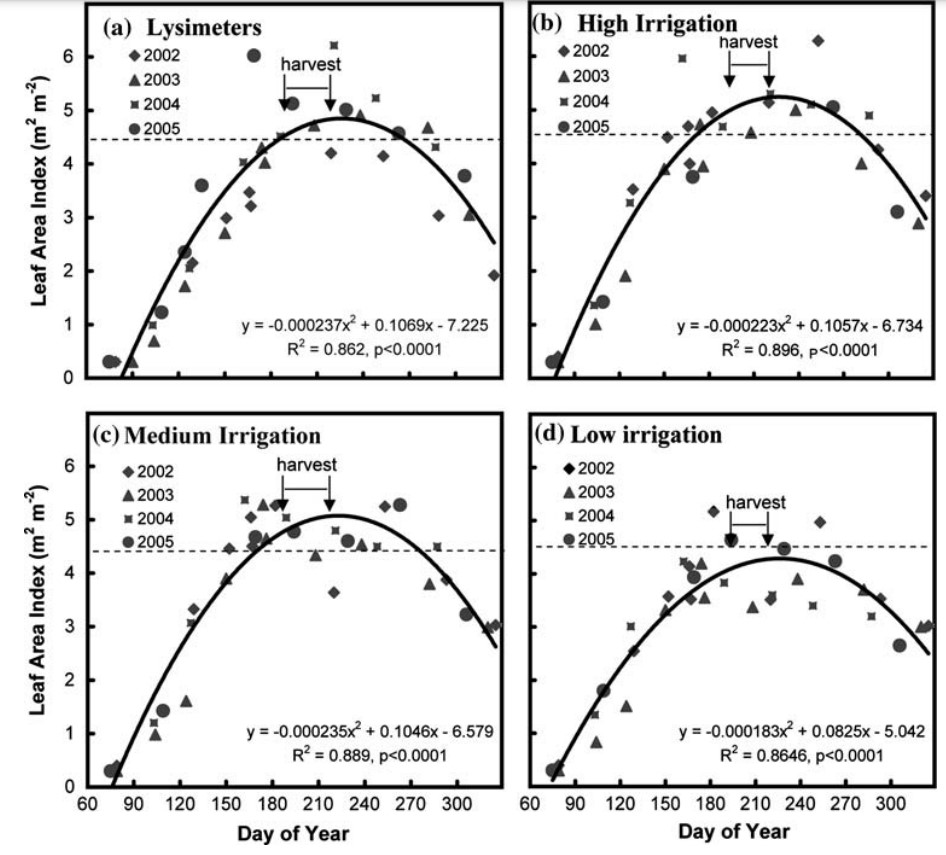

In [33]:
Image("C:\\Users\marco\Desktop\progetto_idrologia_Evaptra\JupyterNotebook\LAI_calculation.jpg")

In [34]:
tabs=os.chdir(oms_project_path+'/data/Calliano/1')
#os.listdir()

## **Variazione del LAI e della quantità di radiazione al suolo**

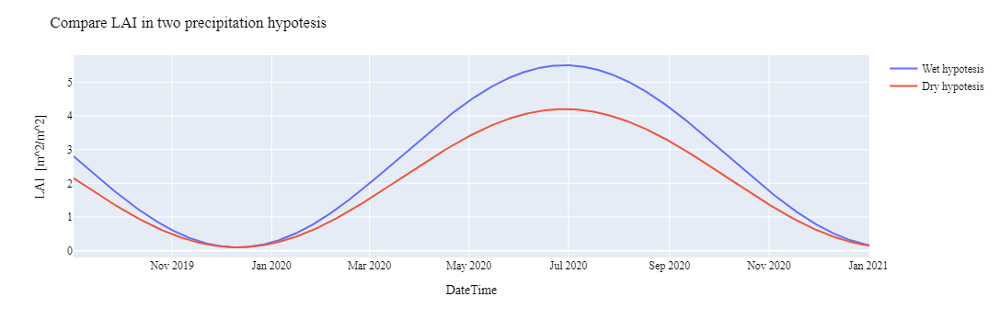

In [35]:
dlai = pd.read_csv('LAI_dry_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
dlai.columns = ['Datetime','Surface']
wlai = pd.read_csv('LAI_wet_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
wlai.columns = ['Datetime','Surface']

fig = px.line()
fig.add_trace(go.Scatter(x=wlai['Datetime'], y=wlai['Surface'], mode='lines', name='Wet hypotesis'))
fig.add_trace(go.Scatter(x=dlai['Datetime'], y=dlai['Surface'], mode='lines', name='Dry hypotesis'))

fig.update_layout(
    title='Compare LAI in two precipitation hypotesis',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="LAI  [m^2/m^2]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()


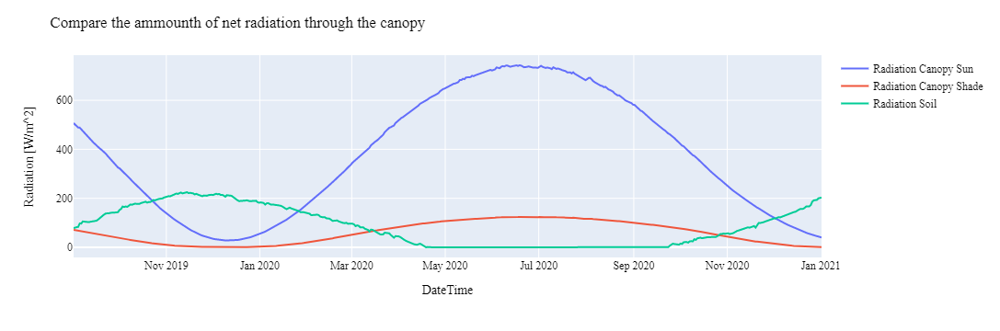

In [36]:
os.chdir(oms_project_path+'/output/Calliano/1')
df1 = pd.read_csv('RadiationCanopySun_1_potential_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df1.columns = ['Datetime','Radiation']
df2 = pd.read_csv('RadiationCanopyShade_1_potential_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Datetime','Radiation']
df3 = pd.read_csv('RadiationSoil_1_potential_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df3.columns = ['Datetime','Radiation']

fig = px.line()
fig.add_trace(go.Scatter(x=df1['Datetime'], y=df1['Radiation'], mode='lines', name='Radiation Canopy Sun'))
fig.add_trace(go.Scatter(x=df2['Datetime'], y=df2['Radiation'], mode='lines', name='Radiation Canopy Shade'))
fig.add_trace(go.Scatter(x=df3['Datetime'], y=df3['Radiation'], mode='lines', name='Radiation Soil'))

fig.update_layout(
    title='Compare the ammounth of net radiation through the canopy',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Radiation [W/m^2]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

# Analisi delle Previsioni di Precipitazione e contenuto d'acqua nel suolo

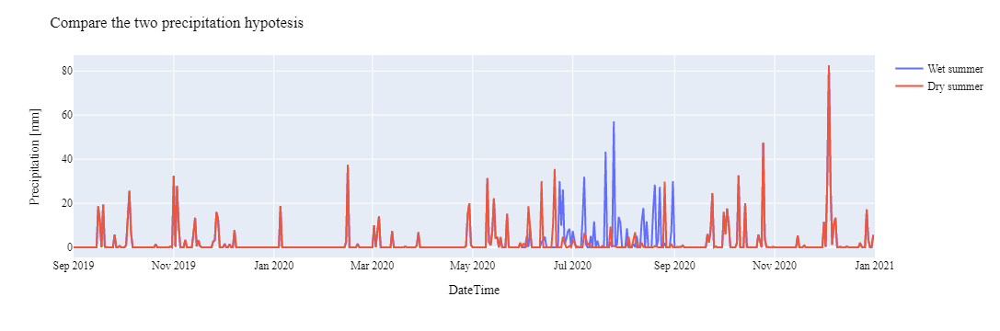

In [37]:
tabs=os.chdir(oms_project_path+'/data/Calliano/1')
ws = pd.read_csv('precip_wet_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
ws.columns = ['Datetime','Precipitation']
ds = pd.read_csv('precip_dry_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
ds.columns = ['Datetime','Precipitation']

fig = px.line()
fig.add_trace(go.Scatter(x=ws['Datetime'], y=ws['Precipitation'], mode='lines', name='Wet summer'))
fig.add_trace(go.Scatter(x=ds['Datetime'], y=ds['Precipitation'], mode='lines', name='Dry summer'))

fig.update_layout(
    title='Compare the two precipitation hypotesis',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Precipitation [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()


Altezza delle due serie temporali di precipitazione
con estate piovosa (491 mm)

In [38]:
ws['Precipitation'].sum()

1396.2000000000003

con estate secca (195 mm)

In [39]:
ds['Precipitation'].sum()

1100.2

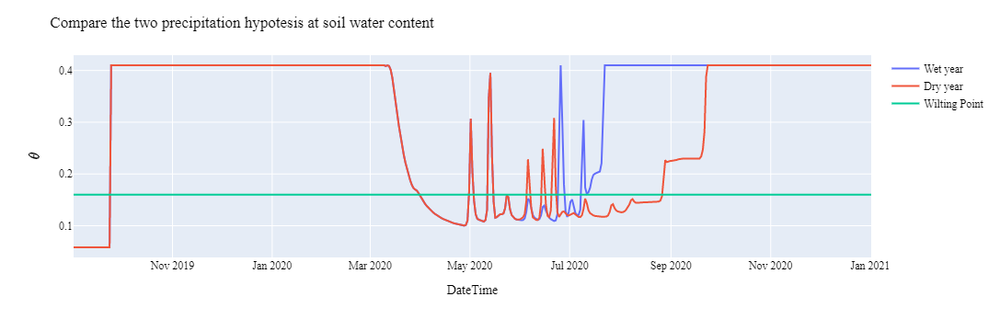

In [40]:
ws = pd.read_csv('soilmoisture_wet_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
ws.columns = ['Datetime','Precipitation']
ds = pd.read_csv('soilmoisture_dry_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
ds.columns = ['Datetime','Precipitation']
wp = pd.read_csv('WiltingPoint.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
wp.columns = ['Datetime','Precipitation']

fig = px.line()
fig.add_trace(go.Scatter(x=ws['Datetime'], y=ws['Precipitation'], mode='lines', name='Wet year'))
fig.add_trace(go.Scatter(x=ds['Datetime'], y=ds['Precipitation'], mode='lines', name='Dry year'))
fig.add_trace(go.Scatter(x=wp['Datetime'], y=wp['Precipitation'], mode='lines', name='Wilting Point'))

fig.update_layout(
    title='Compare the two precipitation hypotesis at soil water content',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Soil water content [$\\theta$] ",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Per la simulazione dell' inflitrazione dell' acqua nel suolo abbiamo posto come condizione al contorno una suzione iniziale pari a -7 m

---
### **Analiziamo le quantità di evaporazione,traspirazione ed evapotraspirazione**

In [77]:
os.chdir(oms_project_path+'/output/Calliano/1')
#os.listdir()

['.ipynb_checkpoints',
 '20_21_t.CSV',
 '35-36.csv',
 'canopy_1_environmentalstress_dry.csv',
 'canopy_1_environmentalstress_wet.csv',
 'canopy_1_potential_dry.csv',
 'canopy_1_potential_wet.csv',
 'canopy_1_totalstress_dry.csv',
 'canopy_1_totalstress_wet.csv',
 'canopy_1_waterstress_dry.csv',
 'canopy_1_waterstress_wet.csv',
 'Evaporation_1_environmentalstress_dry.csv',
 'Evaporation_1_environmentalstress_wet.csv',
 'Evaporation_1_potential_dry.csv',
 'Evaporation_1_potential_wet.csv',
 'Evaporation_1_totalstress_dry.csv',
 'Evaporation_1_totalstress_wet.csv',
 'Evaporation_1_waterstress_dry.csv',
 'Evaporation_1_waterstress_wet.csv',
 'Evaporation_FAO20_1.csv',
 'Evaporation_FAO35_1.csv',
 'EvapoTranspiration_1_environmentalstress_dry.csv',
 'EvapoTranspiration_1_environmentalstress_wet.csv',
 'EvapoTranspiration_1_potential_dry.csv',
 'EvapoTranspiration_1_potential_wet.csv',
 'EvapoTranspiration_1_totalstress_dry.csv',
 'EvapoTranspiration_1_totalstress_wet.csv',
 'EvapoTranspirat

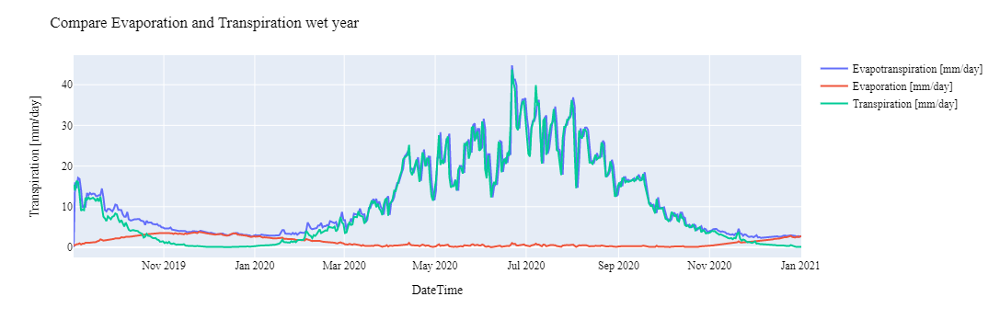

In [85]:
df4 = pd.read_csv('EvapoTranspiration_1_potential_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','Evapotranspiration [mm/day]']
df5 = pd.read_csv('Evaporation_1_potential_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','Evaporation [mm/day]']
df6 = pd.read_csv('Transpiration_1_potential_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','Transpiration [mm/day]']

fig = px.line()
fig.add_trace(go.Scatter(x=df4['Datetime'], y=df4['Evapotranspiration [mm/day]'], mode='lines', name='Evapotranspiration [mm/day]'))
fig.add_trace(go.Scatter(x=df5['Datetime'], y=df5['Evaporation [mm/day]'], mode='lines', name='Evaporation [mm/day]'))
fig.add_trace(go.Scatter(x=df6['Datetime'], y=df6['Transpiration [mm/day]'], mode='lines', name='Transpiration [mm/day]'))

fig.update_layout(
    title='Compare Evaporation and Transpiration wet year',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Transpiration [mm/day] ",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

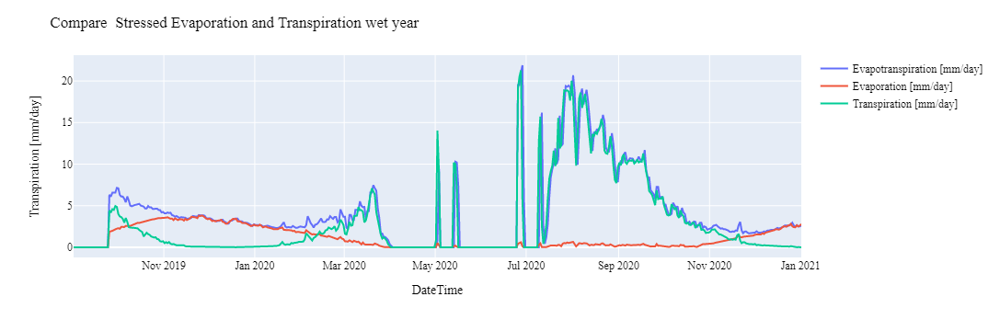

In [86]:
df4 = pd.read_csv('EvapoTranspiration_1_totalstress_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','Evapotranspiration [mm/day]']
df5 = pd.read_csv('Evaporation_1_totalstress_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','Evaporation [mm/day]']
df6 = pd.read_csv('Transpiration_1_totalstress_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','Transpiration [mm/day]']

fig = px.line()
fig.add_trace(go.Scatter(x=df4['Datetime'], y=df4['Evapotranspiration [mm/day]'], mode='lines', name='Evapotranspiration [mm/day]'))
fig.add_trace(go.Scatter(x=df5['Datetime'], y=df5['Evaporation [mm/day]'], mode='lines', name='Evaporation [mm/day]'))
fig.add_trace(go.Scatter(x=df6['Datetime'], y=df6['Transpiration [mm/day]'], mode='lines', name='Transpiration [mm/day]'))

fig.update_layout(
    title='Compare  Stressed Evaporation and Transpiration wet year',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Transpiration [mm/day] ",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

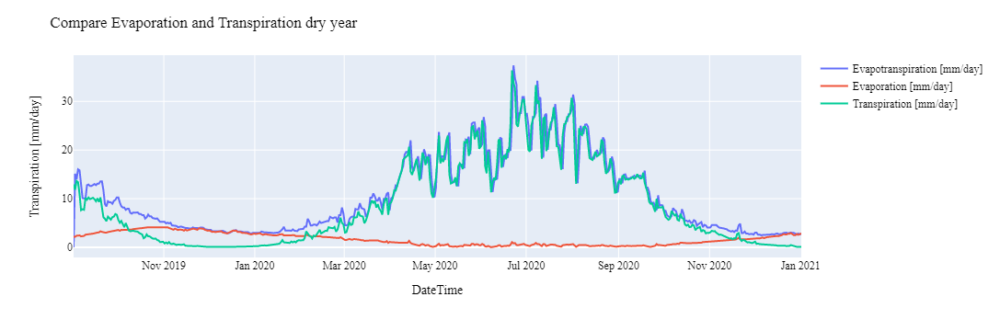

In [87]:
df4 = pd.read_csv('EvapoTranspiration_1_potential_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','Evapotranspiration [mm/day]']
df5 = pd.read_csv('Evaporation_1_potential_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','Evaporation [mm/day]']
df6 = pd.read_csv('Transpiration_1_potential_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','Transpiration [mm/day]']

fig = px.line()
fig.add_trace(go.Scatter(x=df4['Datetime'], y=df4['Evapotranspiration [mm/day]'], mode='lines', name='Evapotranspiration [mm/day]'))
fig.add_trace(go.Scatter(x=df5['Datetime'], y=df5['Evaporation [mm/day]'], mode='lines', name='Evaporation [mm/day]'))
fig.add_trace(go.Scatter(x=df6['Datetime'], y=df6['Transpiration [mm/day]'], mode='lines', name='Transpiration [mm/day]'))

fig.update_layout(
    title='Compare Evaporation and Transpiration dry year',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Transpiration [mm/day] ",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

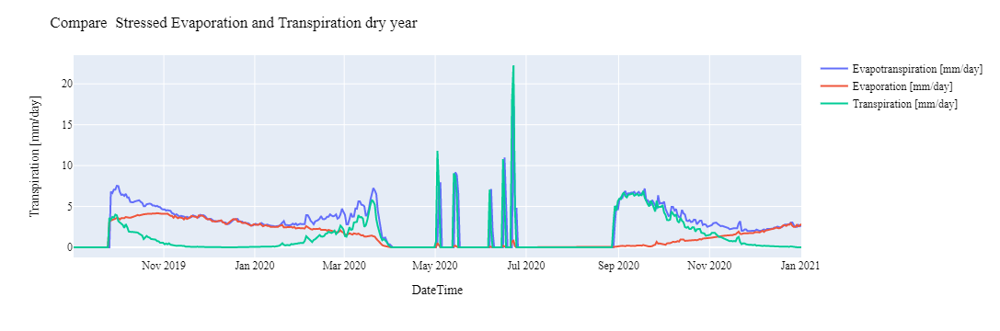

In [89]:
df4 = pd.read_csv('EvapoTranspiration_1_totalstress_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','Evapotranspiration [mm/day]']
df5 = pd.read_csv('Evaporation_1_totalstress_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','Evaporation [mm/day]']
df6 = pd.read_csv('Transpiration_1_totalstress_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','Transpiration [mm/day]']

fig = px.line()
fig.add_trace(go.Scatter(x=df4['Datetime'], y=df4['Evapotranspiration [mm/day]'], mode='lines', name='Evapotranspiration [mm/day]'))
fig.add_trace(go.Scatter(x=df5['Datetime'], y=df5['Evaporation [mm/day]'], mode='lines', name='Evaporation [mm/day]'))
fig.add_trace(go.Scatter(x=df6['Datetime'], y=df6['Transpiration [mm/day]'], mode='lines', name='Transpiration [mm/day]'))

fig.update_layout(
    title='Compare  Stressed Evaporation and Transpiration dry year',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Transpiration [mm/day] ",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

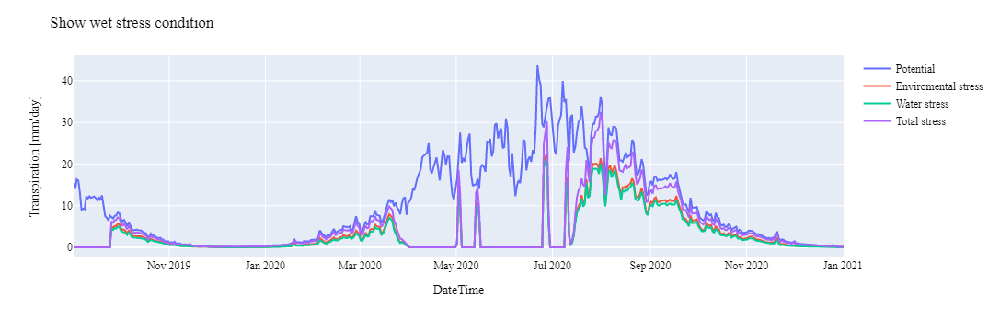

In [95]:
df4 = pd.read_csv('Transpiration_1_potential_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','Transpiration [mm/day]']
df5 = pd.read_csv('Transpiration_1_environmentalstress_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','Transpiration [mm/day]']
df6 = pd.read_csv('Transpiration_1_totalstress_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','Transpiration [mm/day]']
df7 = pd.read_csv('Transpiration_1_waterstress_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df7.columns = ['Datetime','Transpiration [mm/day]']

fig = px.line()
fig.add_trace(go.Scatter(x=df4['Datetime'], y=df4['Transpiration [mm/day]'], mode='lines', name='Potential'))
fig.add_trace(go.Scatter(x=df5['Datetime'], y=df5['Transpiration [mm/day]'], mode='lines', name='Enviromental stress'))
fig.add_trace(go.Scatter(x=df6['Datetime'], y=df6['Transpiration [mm/day]'], mode='lines', name='Water stress'))
fig.add_trace(go.Scatter(x=df7['Datetime'], y=df7['Transpiration [mm/day]'], mode='lines', name='Total stress'))

fig.update_layout(
    title='Show wet stress condition',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Transpiration [mm/day] ",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

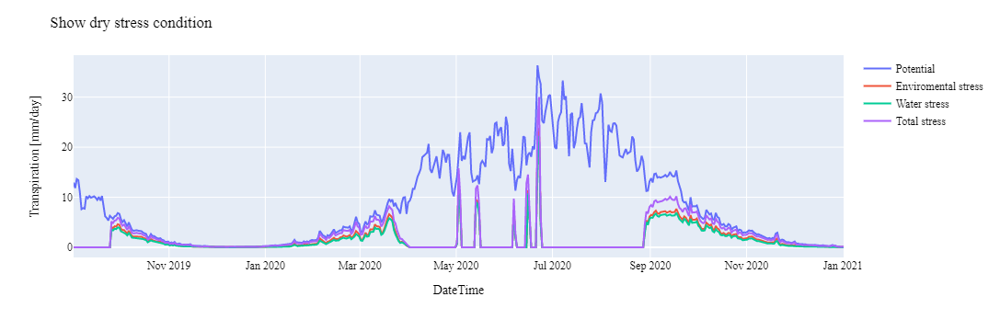

In [96]:
df4 = pd.read_csv('Transpiration_1_potential_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','Transpiration [mm/day]']
df5 = pd.read_csv('Transpiration_1_environmentalstress_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','Transpiration [mm/day]']
df6 = pd.read_csv('Transpiration_1_totalstress_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','Transpiration [mm/day]']
df7 = pd.read_csv('Transpiration_1_waterstress_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df7.columns = ['Datetime','Transpiration [mm/day]']

fig = px.line()
fig.add_trace(go.Scatter(x=df4['Datetime'], y=df4['Transpiration [mm/day]'], mode='lines', name='Potential'))
fig.add_trace(go.Scatter(x=df5['Datetime'], y=df5['Transpiration [mm/day]'], mode='lines', name='Enviromental stress'))
fig.add_trace(go.Scatter(x=df6['Datetime'], y=df6['Transpiration [mm/day]'], mode='lines', name='Water stress'))
fig.add_trace(go.Scatter(x=df7['Datetime'], y=df7['Transpiration [mm/day]'], mode='lines', name='Total stress'))

fig.update_layout(
    title='Show dry stress condition',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Transpiration [mm/day] ",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

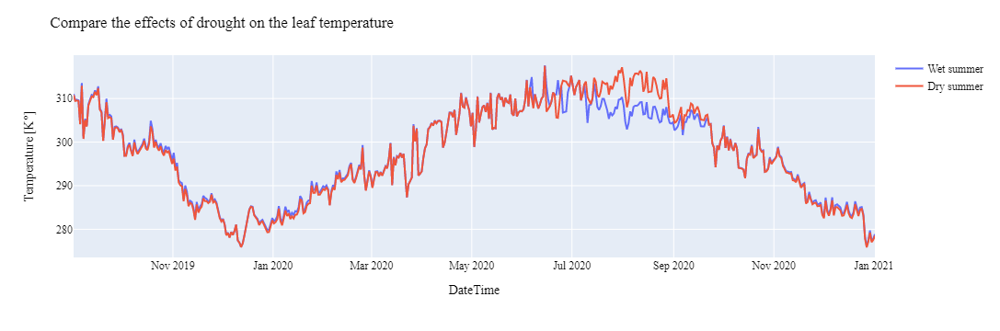

In [52]:
LT_w = pd.read_csv('LT_Sun_1_totalstress_wet.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
LT_w.columns = ['Datetime','Temperature']
LT_d = pd.read_csv('LT_Sun_1_totalstress_dry.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
LT_d.columns = ['Datetime','Temperature']

fig = px.line()
fig.add_trace(go.Scatter(x=LT_w['Datetime'], y=LT_w['Temperature'], mode='lines', name='Wet summer'))
fig.add_trace(go.Scatter(x=LT_d['Datetime'], y=LT_d['Temperature'], mode='lines', name='Dry summer'))

fig.update_layout(
    title='Compare the effects of drought on the leaf temperature',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Temperature [K°]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Si può evincere dalle simulazioni che nella prospettiva di un' estate siccitosa, a causa degli stress ambientali vi è un azzeramento dell' evapotraspirazione. Questo comporatamento è attribuibile ad una situazione di stress idrico molto grave per le piante: l'umidità del suolo scende al di sotto del punto di appassimento (wilting point).
Una situazione di stress simili nei mesi di crescita e fruttificazione può portare ad una drastica riduzione della produzione se non adirittura alla perdita del raccolto. Perciò per ovviare a questo problema è necessario l'aporto tramite irrigazione dell' acqua necessaria a garantire la vitalità delle piante. Quindi il modello è in grado di mettere al corrente gli agricoltori in quali periodi è necessario prestare maggiori cure.

---

---
# **Confronto tra l'evapotraspirazione del bosco di abeti rossi pre-Vaia (2018) e post-Vaia**
Basato sui notebook di Concetta D'Amato, Niccolò Tubini, Michele Bottazzi e Riccardo Rigon.
   
Autori: Niccolò Schiavi Cappello, Marco Feltrin e Alessandro Lagrecacolonna. 

Licence Creative Commons 4.0

In [68]:
os.chdir('C://Users/marco/Desktop/progetto_idrologia_Evaptra/output/lavaze/1')

Il notebook si prefigge lo scopo di analizzare le differenze di evapotraspirazione che si sono create su di un pendio colpito da Vaia prima e dopo l'avvento della tempesta. In questo caso si è presa in analisi una porzione di territorio contigua al passo Lavazè, dove la tempesta Vaia ha completamente estirpato il bosco di abeti rossi lasciando così il terreno spoglio di vegetazione fatta eccezione di specie erbacee.
I dati meteorologici sono stati ricavati da Meteotrentino, mentre il DTM proviene dal portale geocartografico della provincia autonoma di Trento.

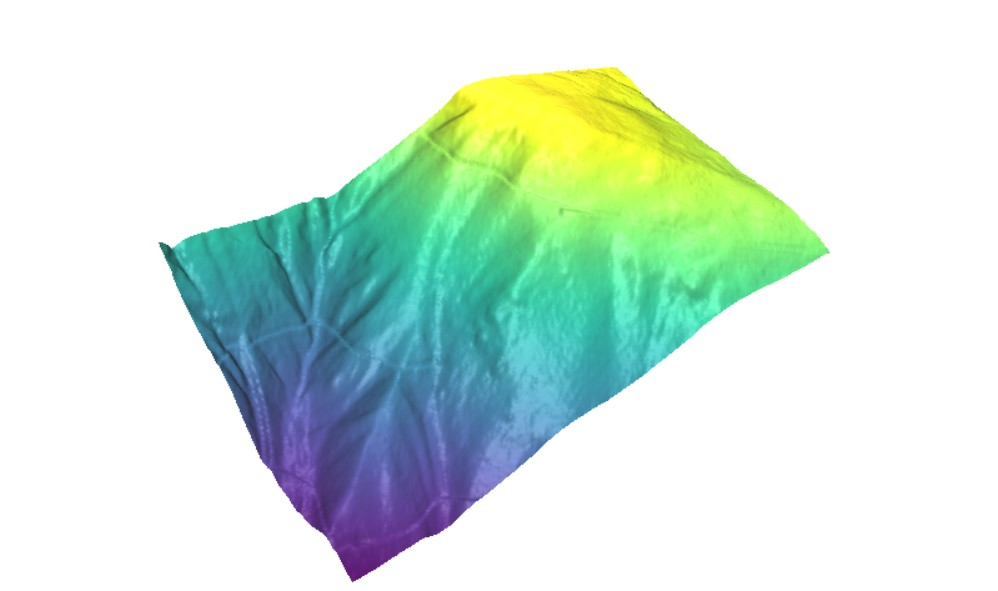

In [54]:
Image('C:/Users/marco/Desktop/progetto_idrologia_Evaptra/output/lavaze/1/dtm.jpg')

DTM del terreno oggetto dello studio

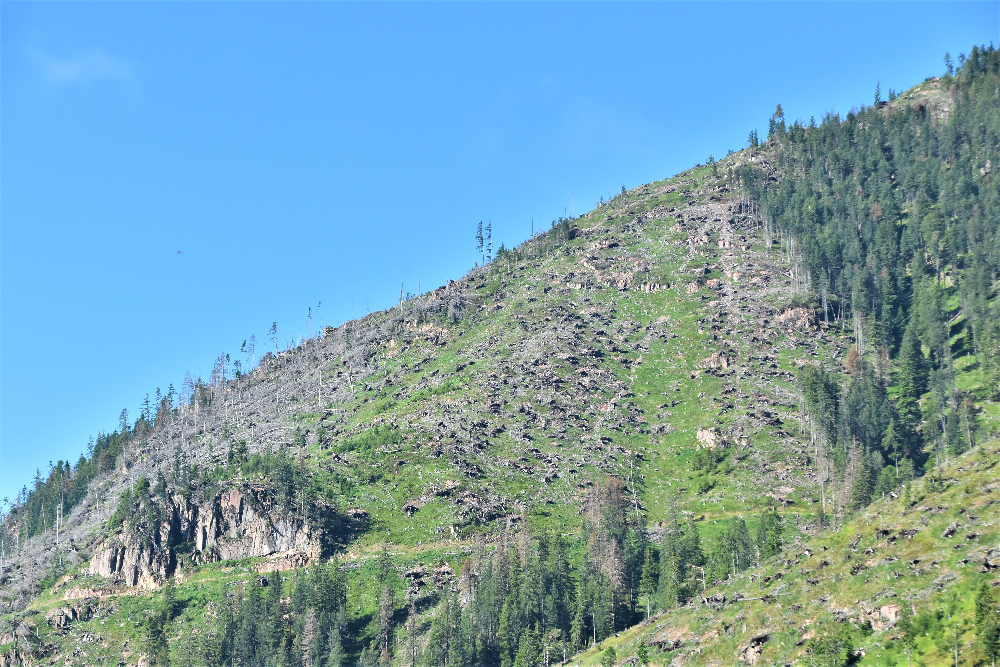

In [55]:
Image('C:/Users/marco/Desktop/progetto_idrologia_Evaptra/output/lavaze/1/DSC_4212.jpg')

Situazione post-Vaia del bosco, grandi aree verdi prive di copertura boschiva.

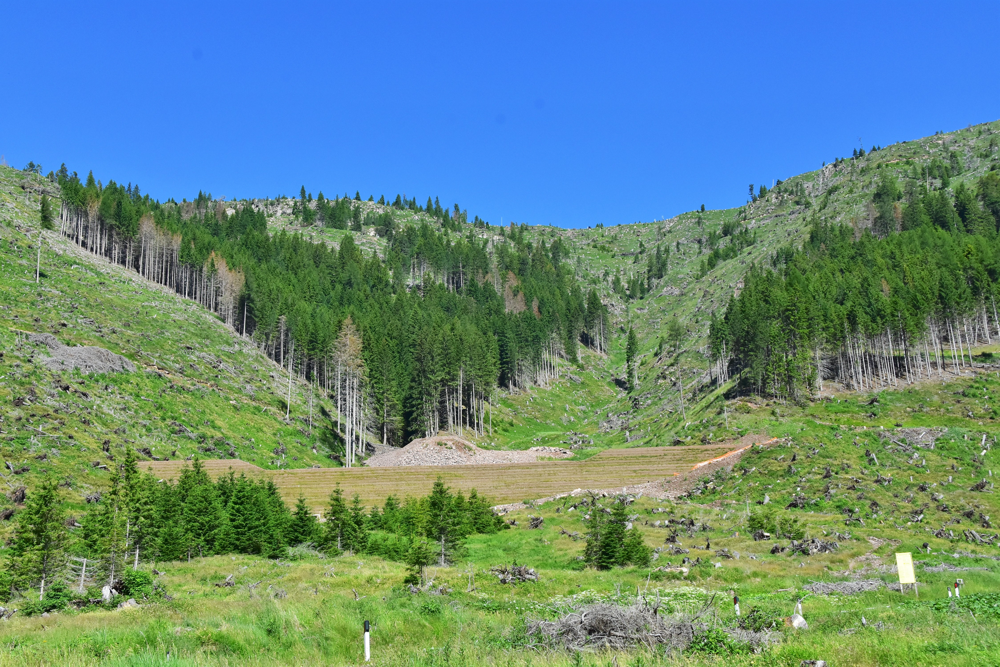

In [56]:
Image('C:/Users/marco/Desktop/progetto_idrologia_Evaptra/output/lavaze/1/DSC_4239.jpg')

Sono state realizzate strutture di difesa del territorio a causa dell'incremento del rischio di nucleazione e scarico delle valanghe.

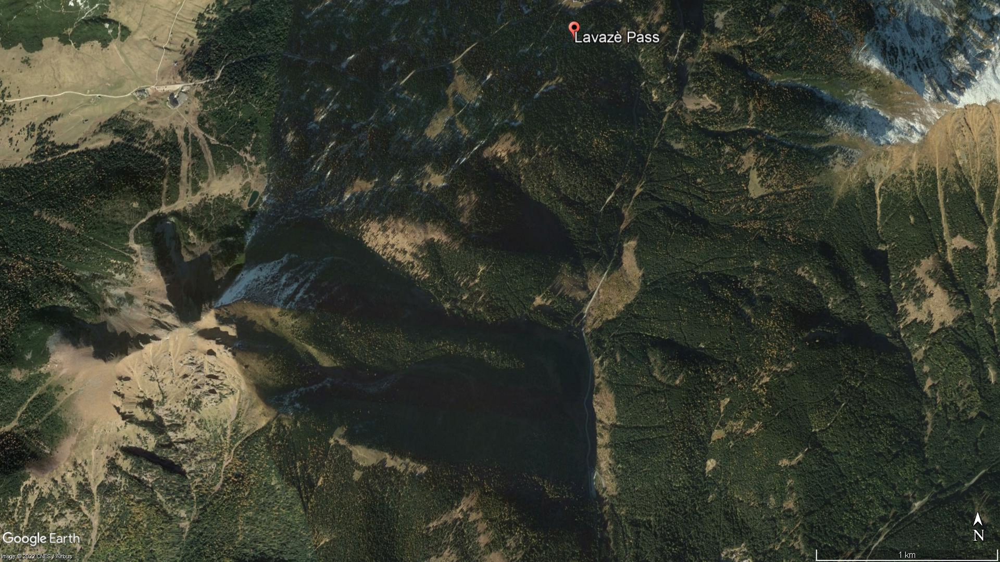

In [57]:
Image('C:/Users/marco/Desktop/progetto_idrologia_Evaptra/output/lavaze/1/passo_Lavaze.jpg')

Ortofoto del terreno pre-Vaia, in cui si nota come la zona fosse per intero un bosco di abeti rossi.

Per studiare il fenomeno si è deciso di usare le formulazioni di Priestley Taylor per l'evapotraspirazione delle conifere.

### **Priestley Taylor**
La formula per la modellizzazione dell'evapotraspirazione di P-T:

\begin{equation}
ET_{0}^{PT} = \alpha\dfrac{\Delta\cdot (R_{n} - G)}{\Delta+\gamma}
\end{equation}
Con:
\begin{equation}
 G =  \begin{cases}
   G_{morn}\cdot R_{n} \quad daylight\\G_{night}\cdot R_{n} \quad nighttime
   \end{cases} 
\end{equation}
Dove:
- $ET_{0}$ o $ET$ sono espresse in [$mm \cdot day^{−1}$] o [$mm\cdot hour^{−1}$]; 
- $R_{n}$ è la radiazione netta espressa in [$MJ \cdot m^{2} \cdot day^{−1}$] o [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $G$ è il flusso di calore latente alla superficie del suolo in [$MJ \cdot m^{2} \cdot day^{−1}$] o [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $\Delta$ è la pendenza della curva della saturazione di vapore espressa in ($kP_{a}\dot °C^{−1}$); 
- $\gamma$ è la costante psicrometrica espressa in ($kP_{a} \cdot$ °$C^{−1}$); 

### **Input**
La simulazione ipotizza due scenari, con la presenza di un bosco di abete rosso, nel primo caso di una situazione non stressata ideale, mentre nel secondo caso in presenza dei fattori di stress. Gli scenari sono calcolati in due anni con un riferimento giornaliero alle 12:00 di ogni giorno dal 1-1-2019 al 1-1-2021. I dati utilizzati provengono dalle vicine stazioni meteo di Predazzo (TN).

- #### **Dem e centroide**
- #### **Temperatura dell'aria**
- #### **Radiazione netta al suolo**
- #### **Pressione atmosferica**
- #### **$G_{morn}$ calore latente al suolo**
$G_{morn}$ è il coeeficiente per il flusso di calore al suolo durante il giorno
- #### **$G_{night}$ calore latente al suolo**
$G_{night}$ è il coefficiente per il flusso di calore al suolo durante la notte
- #### **Data di inizio e di fine**
- #### **$\alpha$, parametro di P-T**

### **Output**


- #### **Serie temporale dell'evapotraspirazione (mm)**

- #### **Serie temporale del calore latente (W/m$^{2}$)**

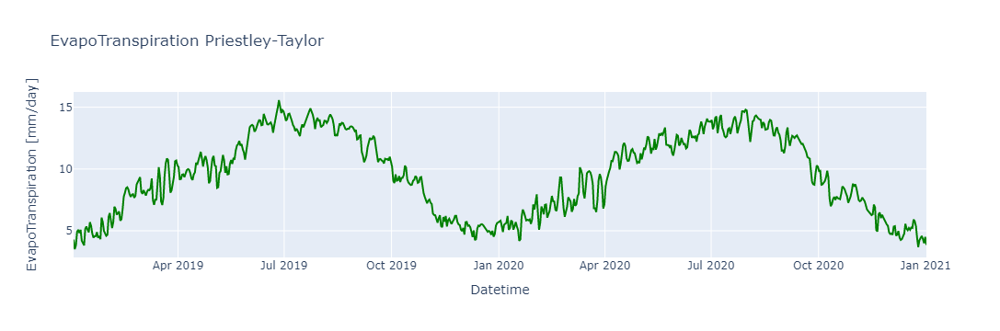

In [69]:
df = pd.read_csv('Evapotranspiration_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Datetime','EvapoTranspiration [mm/day]']
fig = px.line(df, x='Datetime', y='EvapoTranspiration [mm/day]', title='EvapoTranspiration Priestley-Taylor')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Evapotraspirazione ideale di un abete rosso nei due anni presi in considerazione, in base all'andamento annuale delle condizioni.

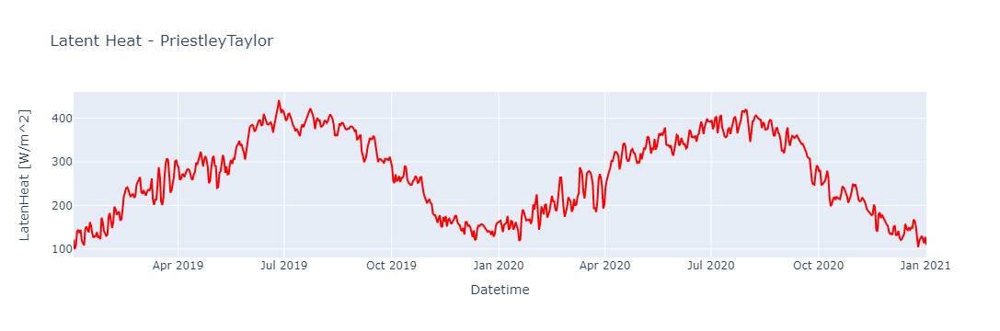

In [63]:
df2 = pd.read_csv('LatentHeat_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Datetime','LatenHeat [W/m^2]']
fig = px.line(df2, x='Datetime', y='LatenHeat [W/m^2]', title='Latent Heat - PriestleyTaylor')
fig.update_traces(line_color='red')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Calore latente ideale di un abete rosso nei due anni presi in considerazione, in base all'andamento annuale delle condizioni.

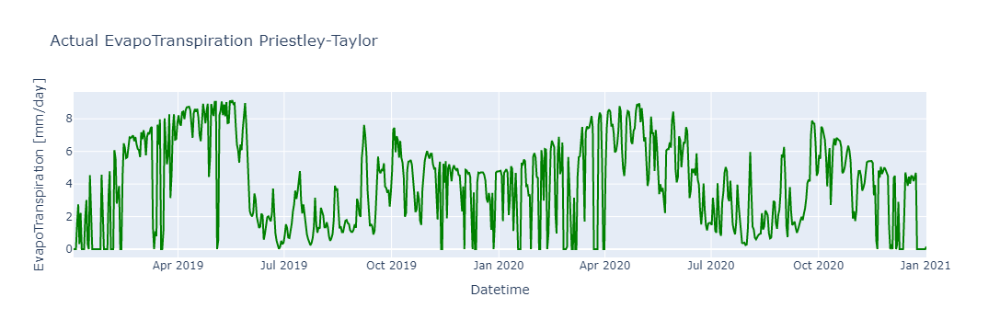

In [70]:
df3 = pd.read_csv('ActualEvapotranspiration_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df3.columns = ['Datetime','EvapoTranspiration [mm/day]']
fig = px.line(df3, x='Datetime', y='EvapoTranspiration [mm/day]', title='Actual EvapoTranspiration Priestley-Taylor')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Evapotraspirazione effettiva di un abete rosso nei due anni presi in considerazione, soggetto ai fattori di stress: temperatura, pressione, umidità .

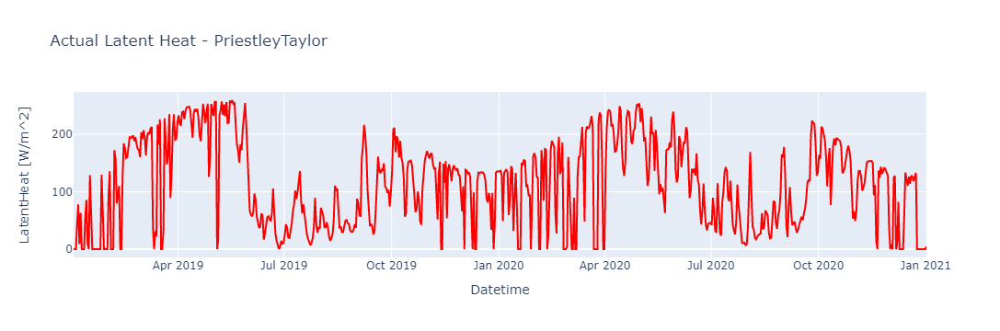

In [65]:
df4 = pd.read_csv('ActualLatentHeat_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Datetime','LatentHeat [W/m^2]']
fig = px.line(df4, x='Datetime', y='LatentHeat [W/m^2]', title='Actual Latent Heat - PriestleyTaylor')
fig.update_traces(line_color='red')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Calore latente effettivo di un abete rosso nei due anni presi in considerazione, soggetto ai fattori di stress: temperatura, pressione, umidità .

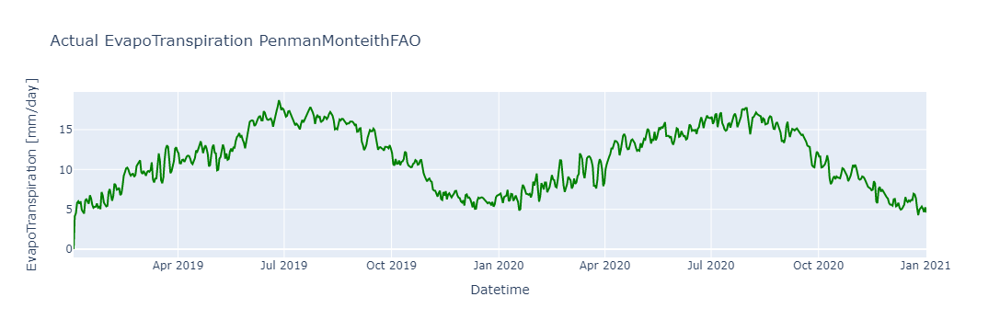

In [74]:
df5 = pd.read_csv('WaterStressedEvaporation_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Datetime','EvapoTranspiration [mm/day]']
fig = px.line(df5, x='Datetime', y='EvapoTranspiration [mm/day]', title='Actual EvapoTranspiration PenmanMonteithFAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Evaporazione del pascolo nel medesimo periodo considerato sottoposto ai fattori di stress:temperatura, pressione, umidità, vento e saturazione dei terreni.

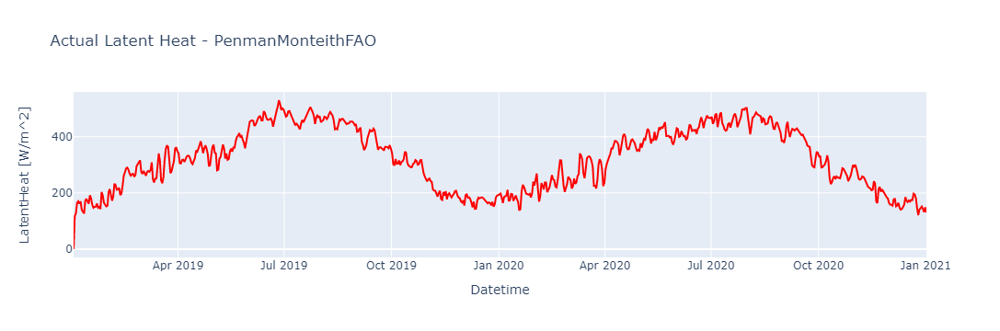

In [62]:
df6 = pd.read_csv('WaterStressedFluxEvaporation_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Datetime','LatentHeat [W/m^2]']
fig = px.line(df6, x='Datetime', y='LatentHeat [W/m^2]', title='Actual Latent Heat - PenmanMonteithFAO')
fig.update_traces(line_color='red')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Calore latente del pascolo nel medesimo periodo considerato sottoposto ai fattori di stress:temperatura, pressione, umidità, vento e saturazione dei terreni.

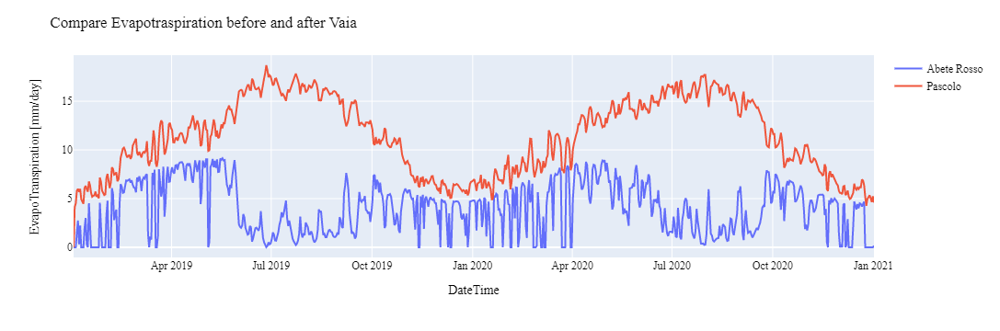

In [76]:
fig = px.line()
fig.add_trace(go.Scatter(x=df['Datetime'], y=df3['EvapoTranspiration [mm/day]'], mode='lines', name='Abete Rosso')) #dataframe relativo evaporazione potenziale
fig.add_trace(go.Scatter(x=df3['Datetime'], y=df5['EvapoTranspiration [mm/day]'], mode='lines', name='Pascolo'))  #dataframe relativo evaporazione stressata

fig.update_layout(
    title='Compare Evapotraspiration before and after Vaia',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTranspiration [mm/day]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

La diminuzione dell'evaporazione nei mesi estivi negli abeti rossi è dovuta alla chiusura degli stomi. Si nota una significativa differenza nei mesi estivi dell'evaporazione di un pascolo, rispetto a quella di una zona ricoperta da abeti rossi.

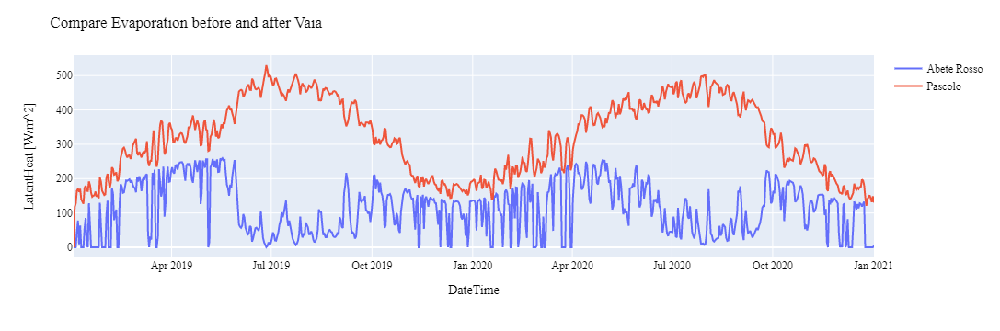

In [62]:
fig = px.line()
fig.add_trace(go.Scatter(x=df4['Datetime'], y=df4['LatentHeat'], mode='lines', name='Abete Rosso')) #dataframe relativo evaporazione potenziale
fig.add_trace(go.Scatter(x=df6['Datetime'], y=df6['LatentHeat'], mode='lines', name='Pascolo'))  #dataframe relativo evaporazione stressata

fig.update_layout(
    title='Compare Evaporation before and after Vaia',
    xaxis_title="DateTime",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="LatentHeat [W/m^2]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Con la chiusura degli stomi il calore latente tende a zero; nei mesi primaverili, ma anche invernali la pianta tende ad evapotraspirare maggiormente.